<a href="https://www.kaggle.com/code/stephyromichan/crimedataanalysis?scriptVersionId=201388536" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session


/kaggle/input/crime-data-analysis/Los_Angeles_Unemp_rate.csv
/kaggle/input/crime-data-analysis/Crime_Data_from_2020_to_Present.csv
/kaggle/input/crime-data-analysis/CPI for All Urban Consumers (CPI-U).csv


In [2]:
#importing all the relevant libraries
import pandas as pd
import numpy as np

#For Visualisation
import plotly.express as px
import plotly.io as pio
pio.renderers.default = 'iframe'
import matplotlib.pyplot as plt
import seaborn as sns
sns.set
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import folium
from folium.plugins import HeatMap

#For descriptive statistics and predictions
from collections import Counter
from scipy import stats
from statsmodels.tsa.arima.model import ARIMA


In [3]:
df = pd.read_csv('/kaggle/input/crime-data-analysis/Crime_Data_from_2020_to_Present.csv')  # Update with your file path
print(df.head())  # Display the first few rows of the dataframe
copy_df = df.copy()

       DR_NO               Date Rptd                DATE OCC  TIME OCC  AREA  \
0  190326475  03/01/2020 12:00:00 AM  03/01/2020 12:00:00 AM      2130     7   
1  200106753  02/09/2020 12:00:00 AM  02/08/2020 12:00:00 AM      1800     1   
2  200320258  11/11/2020 12:00:00 AM  11/04/2020 12:00:00 AM      1700     3   
3  200907217  05/10/2023 12:00:00 AM  03/10/2020 12:00:00 AM      2037     9   
4  220614831  08/18/2022 12:00:00 AM  08/17/2020 12:00:00 AM      1200     6   

   AREA NAME  Rpt Dist No  Part 1-2  Crm Cd  \
0   Wilshire          784         1     510   
1    Central          182         1     330   
2  Southwest          356         1     480   
3   Van Nuys          964         1     343   
4  Hollywood          666         2     354   

                                Crm Cd Desc  ... Status   Status Desc  \
0                          VEHICLE - STOLEN  ...     AA  Adult Arrest   
1                     BURGLARY FROM VEHICLE  ...     IC   Invest Cont   
2                

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 982638 entries, 0 to 982637
Data columns (total 28 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   DR_NO           982638 non-null  int64  
 1   Date Rptd       982638 non-null  object 
 2   DATE OCC        982638 non-null  object 
 3   TIME OCC        982638 non-null  int64  
 4   AREA            982638 non-null  int64  
 5   AREA NAME       982638 non-null  object 
 6   Rpt Dist No     982638 non-null  int64  
 7   Part 1-2        982638 non-null  int64  
 8   Crm Cd          982638 non-null  int64  
 9   Crm Cd Desc     982638 non-null  object 
 10  Mocodes         837376 non-null  object 
 11  Vict Age        982638 non-null  int64  
 12  Vict Sex        844193 non-null  object 
 13  Vict Descent    844182 non-null  object 
 14  Premis Cd       982624 non-null  float64
 15  Premis Desc     982053 non-null  object 
 16  Weapon Used Cd  326167 non-null  float64
 17  Weapon Des

In [5]:
df.shape #view the shape of the dataset (num of row, num of columns)

(982638, 28)

In [6]:
df.describe() #descriptive statistics for floating or integer dtype columns

,DR_NO,TIME OCC,AREA,Rpt Dist No,Part 1-2,Crm Cd,Vict Age,Premis Cd,Weapon Used Cd,Crm Cd 1,Crm Cd 2,Crm Cd 3,Crm Cd 4,LAT,LON
count,9.826380e+05,982638.000000,982638.000000,982638.000000,982638.000000,982638.000000,982638.000000,982624.000000,326167.000000,982627.000000,68875.000000,2311.000000,64.00000,982638.000000,982638.000000
mean,2.197437e+08,1338.945426,10.700277,1116.459887,1.404253,500.823555,29.079817,306.133008,363.840882,500.578668,958.167085,984.204673,991.21875,33.995725,-118.082225
std,1.294954e+07,651.537830,6.107808,610.893787,0.490747,206.211940,21.970094,219.053795,123.684663,206.010361,110.232109,51.485644,27.06985,1.636729,5.672940
min,8.170000e+02,1.000000,1.000000,101.000000,1.000000,110.000000,-4.000000,101.000000,101.000000,110.000000,210.000000,310.000000,821.00000,0.000000,-118.667600
25%,2.106089e+08,900.000000,5.000000,587.000000,1.000000,331.000000,0.000000,101.000000,311.000000,331.000000,998.000000,998.000000,998.00000,34.014600,-118.430500
50%,2.208146e+08,1420.000000,11.000000,1141.000000,1.000000,442.000000,30.000000,203.000000,400.000000,442.000000,998.000000,998.000000,998.00000,34.058900,-118.322500
75%,2.309153e+08,1900.000000,16.000000,1617.000000,2.000000,626.000000,44.000000,501.000000,400.000000,626.000000,998.000000,998.000000,998.00000,34.164900,-118.273900
max,2.499253e+08,2359.000000,21.000000,2199.000000,2.000000,956.000000,120.000000,976.000000,516.000000,956.000000,999.000000,999.000000,999.00000,34.334300,0.000000


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 982638 entries, 0 to 982637
Data columns (total 28 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   DR_NO           982638 non-null  int64  
 1   Date Rptd       982638 non-null  object 
 2   DATE OCC        982638 non-null  object 
 3   TIME OCC        982638 non-null  int64  
 4   AREA            982638 non-null  int64  
 5   AREA NAME       982638 non-null  object 
 6   Rpt Dist No     982638 non-null  int64  
 7   Part 1-2        982638 non-null  int64  
 8   Crm Cd          982638 non-null  int64  
 9   Crm Cd Desc     982638 non-null  object 
 10  Mocodes         837376 non-null  object 
 11  Vict Age        982638 non-null  int64  
 12  Vict Sex        844193 non-null  object 
 13  Vict Descent    844182 non-null  object 
 14  Premis Cd       982624 non-null  float64
 15  Premis Desc     982053 non-null  object 
 16  Weapon Used Cd  326167 non-null  float64
 17  Weapon Des

### Data Cleaning

In [8]:
#Missing values
df.isnull().sum()

DR_NO                  0
Date Rptd              0
DATE OCC               0
TIME OCC               0
AREA                   0
AREA NAME              0
Rpt Dist No            0
Part 1-2               0
Crm Cd                 0
Crm Cd Desc            0
Mocodes           145262
Vict Age               0
Vict Sex          138445
Vict Descent      138456
Premis Cd             14
Premis Desc          585
Weapon Used Cd    656471
Weapon Desc       656471
Status                 1
Status Desc            0
Crm Cd 1              11
Crm Cd 2          913763
Crm Cd 3          980327
Crm Cd 4          982574
LOCATION               0
Cross Street      830789
LAT                    0
LON                    0
dtype: int64

In [9]:
cols_to_drop = ['Crm Cd 1','Crm Cd 2','Crm Cd 3','Crm Cd 4','Cross Street','Weapon Used Cd','Weapon Desc']
df.drop(columns=cols_to_drop, inplace=True)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 982638 entries, 0 to 982637
Data columns (total 21 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   DR_NO         982638 non-null  int64  
 1   Date Rptd     982638 non-null  object 
 2   DATE OCC      982638 non-null  object 
 3   TIME OCC      982638 non-null  int64  
 4   AREA          982638 non-null  int64  
 5   AREA NAME     982638 non-null  object 
 6   Rpt Dist No   982638 non-null  int64  
 7   Part 1-2      982638 non-null  int64  
 8   Crm Cd        982638 non-null  int64  
 9   Crm Cd Desc   982638 non-null  object 
 10  Mocodes       837376 non-null  object 
 11  Vict Age      982638 non-null  int64  
 12  Vict Sex      844193 non-null  object 
 13  Vict Descent  844182 non-null  object 
 14  Premis Cd     982624 non-null  float64
 15  Premis Desc   982053 non-null  object 
 16  Status        982637 non-null  object 
 17  Status Desc   982638 non-null  object 
 18  LOCA

In [10]:
#Renaming the columns
new_columns = {
    'Date Rptd':'DateReported',
    'DATE OCC' : 'DateofCrime',
    'TIME OCC' : 'TimeOccurred',
    'Crm Cd'   : 'CrimeCode',
    'Crm Cd Desc': 'CrimeDescription',
    'Vict Age' : 'VictimAge',
    'Vict Sex' : 'VictimSex',
    'Vict Descent' : 'Ethinicity',
    'LAT' : 'latitude',
    'LON' : 'longitude'
}
df = df.rename(columns = new_columns)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 982638 entries, 0 to 982637
Data columns (total 21 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   DR_NO             982638 non-null  int64  
 1   DateReported      982638 non-null  object 
 2   DateofCrime       982638 non-null  object 
 3   TimeOccurred      982638 non-null  int64  
 4   AREA              982638 non-null  int64  
 5   AREA NAME         982638 non-null  object 
 6   Rpt Dist No       982638 non-null  int64  
 7   Part 1-2          982638 non-null  int64  
 8   CrimeCode         982638 non-null  int64  
 9   CrimeDescription  982638 non-null  object 
 10  Mocodes           837376 non-null  object 
 11  VictimAge         982638 non-null  int64  
 12  VictimSex         844193 non-null  object 
 13  Ethinicity        844182 non-null  object 
 14  Premis Cd         982624 non-null  float64
 15  Premis Desc       982053 non-null  object 
 16  Status            98

In [11]:
#duplicate rows
duplicate_row = df[df.duplicated()]

In [12]:
duplicate_row

,DR_NO,DateReported,DateofCrime,TimeOccurred,AREA,AREA NAME,Rpt Dist No,Part 1-2,CrimeCode,CrimeDescription,...,VictimAge,VictimSex,Ethinicity,Premis Cd,Premis Desc,Status,Status Desc,LOCATION,latitude,longitude


In [13]:
#categorical columns -> Victim Sex
categorical_column = ['VictimSex','Status','Part 1-2']
for value in categorical_column:
    df[value] = df[value].astype('category')
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 982638 entries, 0 to 982637
Data columns (total 21 columns):
 #   Column            Non-Null Count   Dtype   
---  ------            --------------   -----   
 0   DR_NO             982638 non-null  int64   
 1   DateReported      982638 non-null  object  
 2   DateofCrime       982638 non-null  object  
 3   TimeOccurred      982638 non-null  int64   
 4   AREA              982638 non-null  int64   
 5   AREA NAME         982638 non-null  object  
 6   Rpt Dist No       982638 non-null  int64   
 7   Part 1-2          982638 non-null  category
 8   CrimeCode         982638 non-null  int64   
 9   CrimeDescription  982638 non-null  object  
 10  Mocodes           837376 non-null  object  
 11  VictimAge         982638 non-null  int64   
 12  VictimSex         844193 non-null  category
 13  Ethinicity        844182 non-null  object  
 14  Premis Cd         982624 non-null  float64 
 15  Premis Desc       982053 non-null  object  
 16  St

In [14]:
# Convert the 'date_column' to DateTime format

df['DateReported'] = pd.to_datetime(df['DateReported'], format='%m/%d/%Y %I:%M:%S %p')

df['DateofCrime'] = pd.to_datetime(df['DateofCrime'], format='%m/%d/%Y %I:%M:%S %p')

# Extract only the date part (removing time)

df['DateReported'] = pd.to_datetime(df['DateReported'].dt.date)

df['DateofCrime'] = pd.to_datetime(df['DateofCrime'].dt.date)

print(df['DateReported'].dtype)

print(df['DateofCrime'].dtype)

print(df['DateReported'])

print(df['DateofCrime'])
 

datetime64[ns]
datetime64[ns]
0        2020-03-01
1        2020-02-09
2        2020-11-11
3        2023-05-10
4        2022-08-18
            ...    
982633   2024-08-20
982634   2024-07-24
982635   2024-01-15
982636   2024-04-24
982637   2024-08-13
Name: DateReported, Length: 982638, dtype: datetime64[ns]
0        2020-03-01
1        2020-02-08
2        2020-11-04
3        2020-03-10
4        2020-08-17
            ...    
982633   2024-08-17
982634   2024-07-23
982635   2024-01-15
982636   2024-04-24
982637   2024-08-12
Name: DateofCrime, Length: 982638, dtype: datetime64[ns]


In [15]:
#Convert the time column to Time format
df['TimeOccurred'] = copy_df['TIME OCC']
df['TimeOccurred'] = df['TimeOccurred'].astype(str)
df['TimeOccurred'] = df['TimeOccurred'].str.zfill(4)
df['TimeOccurred'] = df['TimeOccurred'].str[:2]+":"+df['TimeOccurred'].str[2:]+":00"
df['TimeOccurred'] = pd.to_datetime(df['TimeOccurred'], format='%H:%M:%S').dt.time
print(df['TimeOccurred'])
# Verify the datatype
print(df['TimeOccurred'].dtype)

0         21:30:00
1         18:00:00
2         17:00:00
3         20:37:00
4         12:00:00
            ...   
982633    23:00:00
982634    14:00:00
982635    01:00:00
982636    15:00:00
982637    23:00:00
Name: TimeOccurred, Length: 982638, dtype: object
object


In [16]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 982638 entries, 0 to 982637
Data columns (total 21 columns):
 #   Column            Non-Null Count   Dtype         
---  ------            --------------   -----         
 0   DR_NO             982638 non-null  int64         
 1   DateReported      982638 non-null  datetime64[ns]
 2   DateofCrime       982638 non-null  datetime64[ns]
 3   TimeOccurred      982638 non-null  object        
 4   AREA              982638 non-null  int64         
 5   AREA NAME         982638 non-null  object        
 6   Rpt Dist No       982638 non-null  int64         
 7   Part 1-2          982638 non-null  category      
 8   CrimeCode         982638 non-null  int64         
 9   CrimeDescription  982638 non-null  object        
 10  Mocodes           837376 non-null  object        
 11  VictimAge         982638 non-null  int64         
 12  VictimSex         844193 non-null  category      
 13  Ethinicity        844182 non-null  object        
 14  Prem

In [17]:
#dealing with negative age group
mean_age = round(df.loc[df['VictimAge'] >= 0, 'VictimAge'].mean())
print("mean_age after excluding negative values ",mean_age)

#replace the negative age with mean age
df['VictimAge'] = df['VictimAge'].apply(lambda x: mean_age if x <= 0 else x)

df.loc[df['VictimAge'] <= 0]

mean_age after excluding negative values  29


,DR_NO,DateReported,DateofCrime,TimeOccurred,AREA,AREA NAME,Rpt Dist No,Part 1-2,CrimeCode,CrimeDescription,...,VictimAge,VictimSex,Ethinicity,Premis Cd,Premis Desc,Status,Status Desc,LOCATION,latitude,longitude


In [18]:
df['VictimSex'].value_counts()#checking the unique values along with their count present in 'Vict Sex' column.

VictimSex
M    396769
F    352750
X     94561
H       112
-         1
Name: count, dtype: int64

In [19]:
df = df[(df['VictimSex'] != 'H') & (df['VictimSex'] != '-')]
df = df.reset_index(drop=True)
#only keeping the rows that have either 'M' or 'F' as value, Let X be prefer not to say. 

In [20]:
df['VictimSex'].value_counts()#checking the unique values along with their count present in 'Vict Sex' column.

VictimSex
M    396769
F    352750
X     94561
-         0
H         0
Name: count, dtype: int64

In [21]:
#Detecting the outliers in the AGE
def detect_outlier(data):
    Q1,Q2,Q3 = np.quantile(data,[ .25,.5,.75])
    IQR = Q3 - Q1
    upper_fence = Q3 + 1.5*IQR
    lower_fence = Q1 - 1.5*IQR
    return data[(data > upper_fence) | (data < lower_fence)]

result = detect_outlier(df['VictimAge'])
print(Counter(result))

fig = make_subplots(
    rows = 1, cols = 1   
)

fig.append_trace(go.Box(y = df['VictimAge'].values,name = 'Age'),row=1,col = 1)
fig.update_layout(height=500, width=1200, title_text="Outliers in Age")
fig.show()

Counter({67: 4703, 68: 4210, 69: 3732, 70: 3459, 71: 3159, 72: 2936, 73: 2755, 74: 2383, 75: 2019, 76: 1869, 77: 1649, 78: 1492, 79: 1256, 80: 1179, 81: 955, 82: 892, 83: 815, 84: 610, 85: 599, 5: 570, 6: 559, 4: 518, 3: 499, 86: 499, 2: 428, 87: 380, 99: 352, 88: 345, 89: 307, 90: 277, 91: 231, 92: 174, 93: 124, 94: 103, 95: 99, 96: 95, 97: 72, 98: 71, 120: 1})


#### We can't remove these outliers because these can be valid cases. But the age 2,3,4 or 120 can be removed by assuming that kids of that age and people older than 98 does not wander in the street alone.

## Exploratory Data Analysis

## Detecting Outliers and Anomalies

<Axes: xlabel='AREA'>

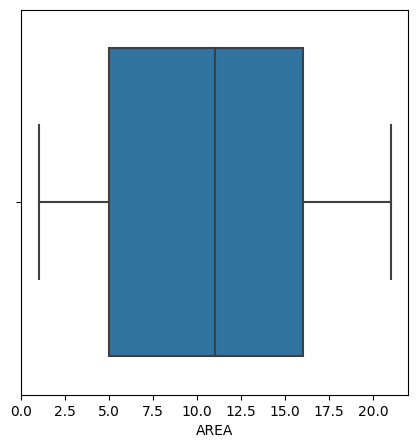

In [22]:
plt.figure(figsize=(5,5))
sns.boxplot(x=df['AREA'])

<Axes: >

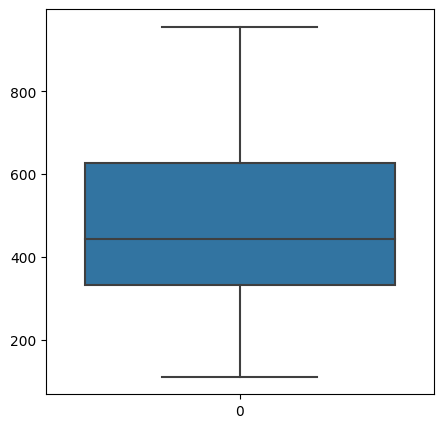

In [23]:
plt.figure(figsize=(5,5)) 
sns.boxplot(df['CrimeCode'])

<Axes: xlabel='VictimAge'>

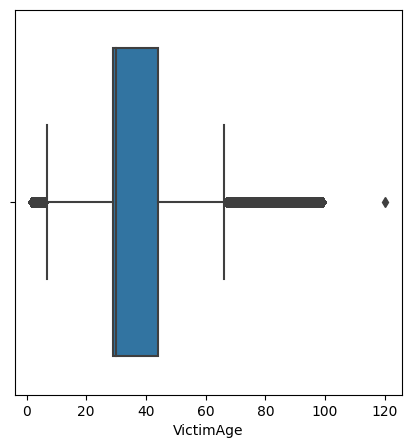

In [24]:
plt.figure(figsize=(5,5)) 
sns.boxplot(x=df['VictimAge'])

<Axes: xlabel='Premis Cd'>

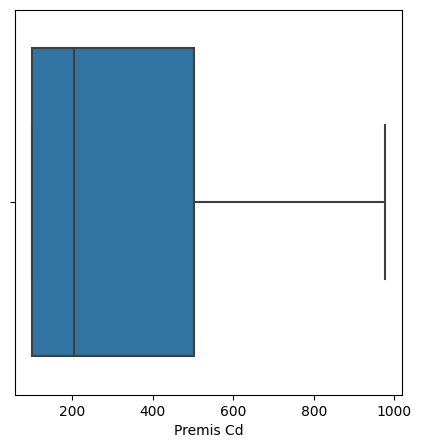

In [25]:
plt.figure(figsize=(5,5)) 
sns.boxplot(x=df['Premis Cd'])

<Axes: >

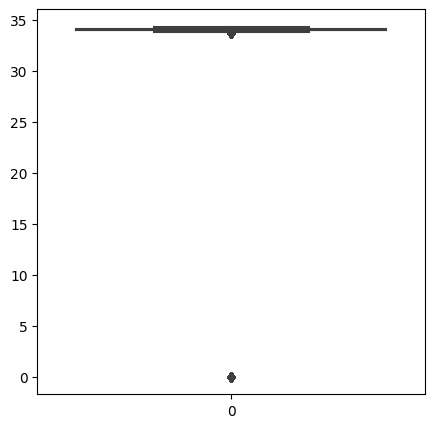

In [26]:

plt.figure(figsize=(5,5)) 
sns.boxplot(df['latitude'])

<Axes: >

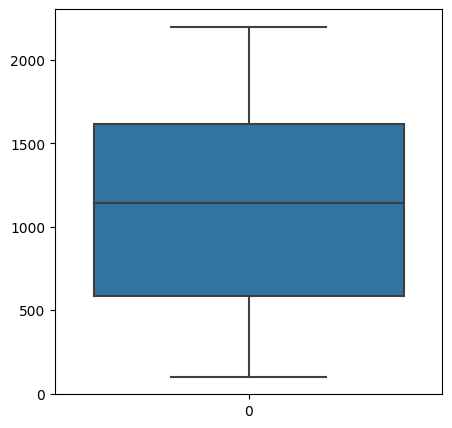

In [27]:
plt.figure(figsize=(5,5)) 
sns.boxplot(df['Rpt Dist No'])

In [28]:
df2=df[df.dtypes[df.dtypes=="int64"].index]

In [29]:
import pandas as pd
from scipy import stats

def find_outliers(dataframe, z_score_threshold=2):
    # Create an empty DataFrame to store the outliers
    outliers_df = pd.DataFrame()

    # Iterate over each column in the DataFrame
    for column in dataframe.columns:
        column_data = dataframe[column]
        z_scores = stats.zscore(column_data)
        outliers = dataframe[abs(z_scores) > z_score_threshold]
        outliers_df = pd.concat([outliers_df, outliers])

    return outliers_df

# Load your data into a DataFrame (replace 'your_data.csv' with your data file)

# Set a Z-Score threshold (adjust as needed)
z_score_threshold = 2

# Call the function to find outliers in every column
outliers_result = find_outliers(df2, z_score_threshold)

# Display the rows containing outliers for each column
outliers_result

,DR_NO,AREA,Rpt Dist No,CrimeCode,VictimAge
0,190326475,7,784,510,29
19466,191501505,15,1543,745,76
39877,817,17,1777,510,29
50869,190101086,1,163,624,25
69553,10304468,3,377,624,36
...,...,...,...,...,...
982481,241407120,14,1466,626,70
982504,241610559,16,1681,354,74
982516,241605270,16,1681,888,79
982519,242004546,20,2013,624,80


## Analysis of the crime over the time

In [30]:
#Most Reported Crimes
crime_group = df.groupby(['CrimeCode','CrimeDescription']).size().reset_index(name = 'Count')
crime_group = crime_group.sort_values('Count', ascending=False)

fig = px.bar(crime_group.head(20),
            x = 'Count',
            y = 'CrimeDescription',
            color = 'Count',
            labels = {'Count':'NumberOfOccurrences'},
            title = 'Most Reported Crimes from 2020 till date' 
            )

fig.update_layout(
    yaxis={'categoryorder':'total ascending'},  # Sort bars in ascending order
    xaxis_title='Number of Occurrences',
    yaxis_title='Crime Description',
    coloraxis_colorbar=dict(title='Count')
)
fig.update_traces(texttemplate='%{x}', textposition='outside')
fig.show()

In [31]:
fig = px.bar(crime_group.tail(20),
            x = 'Count',
            y = 'CrimeDescription',
            color = 'Count',
            labels = {'Count':'NumberOfOccurrences'},
            title = 'Least Reported Crimes from 2020 till date'
            )
fig.update_layout(
    xaxis_title='Number of Occurrences',
    yaxis_title='Crime Description',
    coloraxis_colorbar=dict(title='Count')
)
fig.update_traces(texttemplate='%{x}', textposition='outside')
fig.show()

In [32]:
#df['DateReported'] = pd.to_datetime(df['DateReported'])
df['Year'] = df['DateReported'].dt.year.astype(int)

crimes_by_year = df.groupby('Year').size().reset_index(name='Total Crimes')

fig = px.bar(crimes_by_year, 
              x='Year', 
              y='Total Crimes', 
              color='Year',
              title='Crime Reported by Year',
              labels={'Count': 'Number of Occurrences'},
              height=600)
# Customize the layout
fig.update_layout(
    xaxis_title='Year',
    yaxis_title='Number of Crimes',
    xaxis=dict(
        tickmode='array',
        tickvals=crimes_by_year['Year'].tolist(),
        ticktext=[str(int(year)) for year in crimes_by_year['Year']],
        type='category'
    ),
    coloraxis_showscale=False
)
fig.update_traces(texttemplate='%{y}', textposition='outside')
fig.show()

print(crimes_by_year)

   Year  Total Crimes
0  2020        192691
1  2021        208256
2  2022        235035
3  2023        234622
4  2024        111921


In [33]:
# Assuming 'df' is your DataFrame and 'DateReported' is your date column
df['Year'] = df['DateReported'].dt.year
df['Day of Week'] = df['DateReported'].dt.day_name()

# Function to get top 10 crimes by day of week for a specific year
def get_top_10_crimes_by_day(df, year):
    year_data = df[df['Year'] == year]
    crimes_by_day = year_data.groupby(['Day of Week', 'CrimeDescription']).size().reset_index(name='Count')
    top_crimes = year_data['CrimeDescription'].value_counts().nlargest(10).index
    crimes_by_day_top10 = crimes_by_day[crimes_by_day['CrimeDescription'].isin(top_crimes)]
    return crimes_by_day_top10

# Get unique years from the dataset
years = sorted(df['Year'].unique())

# Create figure
fig = go.Figure()

# Day order
day_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

# Add traces for each year (initially invisible)
# Create figure
fig = go.Figure()

# Add traces for each year (all invisible initially)
for year in years:
    crimes_by_day_top10 = get_top_10_crimes_by_day(df, year)
    for crime in crimes_by_day_top10['CrimeDescription'].unique():
        crime_data = crimes_by_day_top10[crimes_by_day_top10['CrimeDescription'] == crime]
        crime_data = crime_data.set_index('Day of Week').reindex(day_order).reset_index()
        fig.add_trace(
            go.Bar(
                x=crime_data['Day of Week'],
                y=crime_data['Count'],
                name=crime,
                visible=False  # Set all traces to invisible initially
            )
        )

# Create and add dropdown menu
dropdown_buttons = [dict(
    method='update',
    label='Select Year',
    args=[{'visible': [False] * len(fig.data)},
          {'title': 'Select a year to view data'}]
)]

dropdown_buttons += [dict(
    method='update',
    label=str(year),
    args=[{'visible': [y == year for y in years for _ in range(len(get_top_10_crimes_by_day(df, year)['CrimeDescription'].unique()))]},
          {'title': f'Top 10 Crime Types by Day of Week in {year}'}]
) for year in years]

fig.update_layout(
    updatemenus=[dict(
        active=-1,  # Set to -1 so no option is selected by default
        buttons=dropdown_buttons,
        x=0.9,
        y=1.15,
        xanchor='left',
        yanchor='top'
    )],
    title_text="Select a year to view data",
    barmode='stack',
    xaxis_title="Day of Week",
    yaxis_title="Number of Crimes",
    legend_title="Crime Type",
    height=600,
    showlegend=True
)

fig.show()

##### This interactive chart gives the top 10 crimes which is reported over the year 2020 - 2024 and the days on which these crimes are reported the most.

### Analysis of the crime by Area

In [34]:
# Group the data by area/city and count the number of crimes
grp_by_city = df.groupby('AREA NAME')
crime_count_by_area = grp_by_city['CrimeDescription'].count().reset_index().sort_values(by='CrimeDescription', ascending=False)
 
# Print the crime counts for verification
print(crime_count_by_area)
 
# Create a horizontal bar chart
fig = px.bar(
    crime_count_by_area,
    x='CrimeDescription',  # This should be the count of crimes
    y='AREA NAME',        # This should be the area name
    orientation='h',
    title='Crime Counts by Area',
    labels={'CrimeDescription': 'Number of Crimes', 'AREA NAME': 'Area'},
    color='CrimeDescription',  # Coloring by the number of crimes
    color_continuous_scale=px.colors.sequential.Blues
)
 
# Show the figure
fig.show()

      AREA NAME  CrimeDescription
1       Central             67770
0   77th Street             60862
12      Pacific             57806
15    Southwest             55974
6     Hollywood             51319
8   N Hollywood             49975
14    Southeast             49110
11      Olympic             49009
9        Newton             48249
20     Wilshire             47083
13      Rampart             45808
18      West LA             44673
10    Northeast             41890
17     Van Nuys             41882
19  West Valley             41319
2    Devonshire             40839
4        Harbor             40464
16      Topanga             40428
7       Mission             39399
5    Hollenbeck             36113
3      Foothill             32553


In [35]:
grouped_data = df.groupby('AREA NAME')['CrimeDescription'].agg([pd.Series.mode, 'count']).reset_index()
grouped_data.columns = ['AREA NAME', 'Most Common Crime', 'Crime Count']
 
print(grouped_data)

      AREA NAME         Most Common Crime  Crime Count
0   77th Street          VEHICLE - STOLEN        60862
1       Central     BURGLARY FROM VEHICLE        67770
2    Devonshire          VEHICLE - STOLEN        40839
3      Foothill          VEHICLE - STOLEN        32553
4        Harbor          VEHICLE - STOLEN        40464
5    Hollenbeck          VEHICLE - STOLEN        36113
6     Hollywood  BATTERY - SIMPLE ASSAULT        51319
7       Mission          VEHICLE - STOLEN        39399
8   N Hollywood          VEHICLE - STOLEN        49975
9        Newton          VEHICLE - STOLEN        48249
10    Northeast          VEHICLE - STOLEN        41890
11      Olympic          VEHICLE - STOLEN        49009
12      Pacific          VEHICLE - STOLEN        57806
13      Rampart          VEHICLE - STOLEN        45808
14    Southeast          VEHICLE - STOLEN        49110
15    Southwest          VEHICLE - STOLEN        55974
16      Topanga          VEHICLE - STOLEN        40428
17     Van

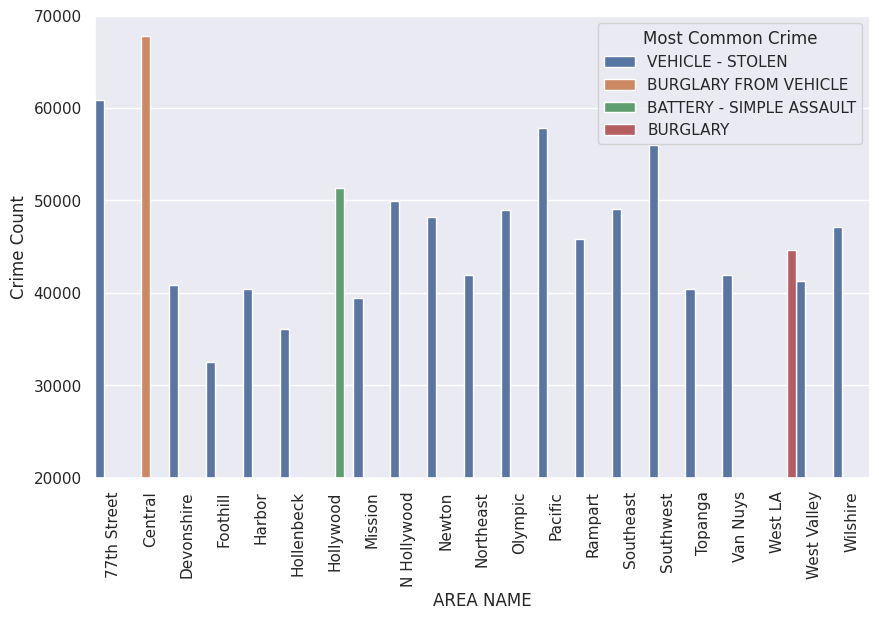

In [36]:
import seaborn as sns
sns.set()
import matplotlib.pyplot as plt
plt.figure(figsize=(10, 6))
plt.xticks(rotation=90)
ax = sns.barplot(x = 'AREA NAME', 
                 y = 'Crime Count', 
                 hue = 'Most Common Crime', 
                 data = grouped_data,
                width = 1)
 
ax.set_ylim(20000, 70000)
plt.show()

In [37]:
fig = px.bar(grouped_data, 
             x='AREA NAME', 
             y='Crime Count', 
             color='Most Common Crime',
             title='Crime Count by Area and Most Common Crime in each area',
             labels={'AREA NAME': 'Area Name', 'Crime Count': 'Crime Count'},
             height=600,
             width=1200)

# Customize the layout
fig.update_layout(
    xaxis_title='Area Name',
    yaxis_title='Crime Count',
    yaxis_range=[20000, 70000],  # Set y-axis range
    xaxis_tickangle=-90,  # Rotate x-axis labels
    legend_title='Most Common Crime',
    barmode='group'  # Group bars instead of stacking
)

# Show the plot
fig.show()

## Demographic Analysis 
### Based on Gender, Ethinicity and Age Group

### Attack on gender

In [38]:
grouped_data_by_gender = df['VictimSex'].value_counts()

In [39]:
#group the gender data into a dataframe
crimes_by_gender = df.groupby('VictimSex',observed=False).size().reset_index(name='Gender')
crimes_by_gender = crimes_by_gender[crimes_by_gender['Gender'] > 0]

#plot the demographics after grouping
fig = px.bar(crimes_by_gender, 
              x='VictimSex', 
              y='Gender', 
              color='VictimSex',
              title='Demographics w.r.t Victim Sex',
              labels={'Count': 'Number of Occurrences'},
              height=600,)

# Customize the layout
fig.update_layout(
    xaxis_title='Victim Sex',
    yaxis_title='Number of Crimes'
)
fig.update_traces(texttemplate='%{y}', textposition='outside')
fig.show()

crimes_by_gender

,VictimSex,Gender
1,F,352750
3,M,396769
4,X,94561


Based on the data provided from the 'Demographics with respect to Gender' we can draw several conclusions about the distribution of crime victims across different gender categories:
<br>
### Gender Distribution:
Male victims (M) are the most numerous, with 396,769 reported cases.
Female victims (F) are the second most common, with 352,750 reported cases.
There's a third category (X) with 94,561 reported cases, which likely represents non-binary, unknown, or unreported gender.<br>
### Male vs. Female Victims:
There are more male victims than female victims, with a difference of 44,019 cases.
Male victims account for approximately 12.5% more cases than female victims. <br>
### Non-Binary or Unknown Gender:
The 'X' category represents a significant number of cases (94,561), which is about 11.2% of the total reported crimes.
This suggests that a notable portion of crime reports either involve victims of non-binary gender, or cases where the victim's gender was unknown or unreported.<br>
### Total Reported Crimes:
The total number of reported crimes across all gender categories is 844,080.<br>
### Proportional Analysis:
Male victims: approximately 47.0% of total cases
Female victims: approximately 41.8% of total cases
'X' category: approximately 11.2% of total cases<br>
### Gender Disparity:
While there is a higher number of male victims, the difference is not overwhelmingly large, suggesting that both males and females are significantly affected by crime.

In [40]:
crimes_by_ethinicity = df.groupby('Ethinicity',observed=False).size().reset_index(name='Count')
crimes_by_ethinicity.sort_values('Count', ascending=True)

fig = px.bar(crimes_by_ethinicity, 
              x='Ethinicity', 
              y='Count', 
              color='Ethinicity',
              title='Demographics w.r.t Ethinicity',
              labels={'Count': 'Number of Occurrences'},
              height=600,)
# Customize the layout
fig.update_layout(
    xaxis_title='Victim Descent',
    yaxis_title='Number of Crimes',
    xaxis={'categoryorder':'total ascending'}  # This ensures the x-axis categories are ordered by the y-values
)
fig.update_traces(texttemplate='%{y}', textposition='outside')
fig.show()

### Hispanic Population:
The Hispanic group (H) has the highest number of incidents at 292,400, which is significantly higher than any other group.
This represents about 34.6% of all reported incidents.<br>
### Top 3 Most Affected Groups:
Hispanic (H): 292,400 incidents (34.6%)<br>
White (W): 197,113 incidents (23.4%)<br>
Black (B): 134,175 incidents (15.9%)<br>
### Other Significant Groups:
Unknown/Unclassified (X): 103,323 incidents (12.2%)<br>
Other (O): 76,707 incidents (9.1%)<br>
Asian (A): 21,027 incidents (2.5%)<br>
### Less Represented Groups:
Several groups have much lower numbers, including K (5,678), F (4,500), C (4,265), J (1,490), V (1,117), and I (968).
### Disparity:
There's a large disparity between the most affected group (Hispanic) and the least affected groups.<br>
The top three groups (Hispanic, White, and Black) account for about 73.9% of all incidents.

In [41]:
def age_group(age):
    if age < 18:
        return 'Kids/Teens (0-17)'
    elif age < 30:
        return 'Young Adults (18-30)'
    elif age < 45:
        return 'Adults (30-44)'
    elif age < 60:
        return 'Middle Aged (45-60)'
    else:
        return 'Old (> 60)'

df['AgeGroup'] = df['VictimAge'].apply(age_group)

In [42]:
crimes_by_age_group = df.groupby('AgeGroup',observed=False).size().reset_index(name='Count')
crimes_by_age_group.sort_values('Count',ascending = True)
fig = px.bar(crimes_by_age_group,
            x = 'AgeGroup',
            y = 'Count',
            color = 'AgeGroup',
            )
fig.update_layout(
    xaxis_title='Age Group of victims',
    yaxis_title='Number of Crimes',
    xaxis={'categoryorder':'total descending'}  # This ensures the x-axis categories are ordered by the y-values
)
fig.show()

crimes_by_age_group

,AgeGroup,Count
0,Adults (30-44),261444
1,Kids/Teens (0-17),25390
2,Middle Aged (45-60),154375
3,Old (> 60),89623
4,Young Adults (18-30),451693


Based on the provided data on crime victims categorized by age groups, we can draw several important conclusions: <br>
### Most Vulnerable Age Group:
Young Adults (18-30) are the most frequently victimized group with 313,262 incidents, representing approximately 37.1% of all reported cases.<br>
### Second Most Affected Group:
Adults (30-44) follow closely with 261,435 incidents, accounting for about 31% of the total.<br>
### Combined Young and Adult Population:
Together, the 18-44 age range (Young Adults and Adults) accounts for 68.1% of all reported incidents, indicating that this broader age group is particularly vulnerable to crime.<br>
### Middle-Aged Victims:
The Middle Aged group (45-60) represents a significant portion with 154,373 incidents (18.3% of the total), showing that crime affects a substantial number of older working-age individuals as well.<br>
### Elderly Victims:
The Old (> 60) category has 89,620 incidents, which is about 10.6% of the total. While lower than other adult categories, this is still a significant number and may indicate particular vulnerabilities for the elderly population.<br>
### Youth Victims:
Kids/Teens (0-17) have the lowest number of incidents at 25,390 (3% of the total). While this is relatively low compared to other groups, it's still a concerning number of incidents involving minors.<br>
### Age Distribution of Crime:
The data shows a clear trend that crime victimization peaks in young adulthood and gradually decreases with age.<br>
### Potential Factors:
The high numbers for Young Adults and Adults might be related to lifestyle factors, increased exposure to public spaces, or economic activities that may put these groups at higher risk.

In [43]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 982525 entries, 0 to 982524
Data columns (total 24 columns):
 #   Column            Non-Null Count   Dtype         
---  ------            --------------   -----         
 0   DR_NO             982525 non-null  int64         
 1   DateReported      982525 non-null  datetime64[ns]
 2   DateofCrime       982525 non-null  datetime64[ns]
 3   TimeOccurred      982525 non-null  object        
 4   AREA              982525 non-null  int64         
 5   AREA NAME         982525 non-null  object        
 6   Rpt Dist No       982525 non-null  int64         
 7   Part 1-2          982525 non-null  category      
 8   CrimeCode         982525 non-null  int64         
 9   CrimeDescription  982525 non-null  object        
 10  Mocodes           837263 non-null  object        
 11  VictimAge         982525 non-null  int64         
 12  VictimSex         844080 non-null  category      
 13  Ethinicity        844069 non-null  object        
 14  Prem

In [44]:
premise_crime = df.groupby('Premis Desc').size().sort_values(ascending=False).reset_index()
premise_crime.columns = ['Premise', 'Crime Count']

fig = px.bar(premise_crime.head(10), x='Premise', y='Crime Count',
             title='Top 10 Premises with Highest Crime Counts',
             labels={'Premise': 'Premise Type', 'Crime Count': 'Number of Crimes'})
fig.show()

### Key Findings<br>
#### Street Crime Dominance: 
Streets are overwhelmingly the most common location for crimes, with 252,219 incidents. This suggests that a significant portion of criminal activity occurs in public spaces.<br>
#### Residential Areas: 
Single-family dwellings and multi-unit dwellings (apartments, duplexes, etc.) are the second and third most common crime locations, with 161,461 and 117,046 incidents respectively. This indicates that residential areas are also major targets for criminal activity.<br>
#### Vehicle-Related Crime: 
Parking lots (67,363 incidents) and passenger vehicles/trucks (28,544 incidents) feature prominently in the list, suggesting that vehicle-related crime is a significant issue.<br>
#### Business Targets: 
arious types of businesses are frequent crime locations, including "Other Business" (46,501), Department Stores (13,675), and Restaurants/Fast Food establishments (12,142).<br>
#### Public Spaces: 
Sidewalks account for a substantial number of crimes (40,419), reinforcing the prevalence of crime in public areas.<br>
### Implications<br>
#### Law Enforcement Focus: 
The high incidence of street crime suggests that increased police patrols and surveillance in public areas might be beneficial.<br>
#### Residential Security: 
Given the high number of crimes in residential areas, there may be a need for improved home security measures and community watch programs.<br>
#### Vehicle Protection: 
The data indicates a need for better security in parking areas and measures to protect vehicles from theft or break-ins.<br>
#### Business Security: 
Businesses, particularly retail establishments, should consider enhancing their security systems and protocols.<br>
#### Urban Planning: 
City planners might use this data to design safer public spaces and implement crime prevention through environmental design (CPTED) principles.<br>
### Conclusion
The crime distribution data reveals that while public spaces like streets and sidewalks are the most common locations for criminal activity, residential areas and businesses are also significantly affected. This suggests a need for a multi-faceted approach to crime prevention that addresses both public and private spaces. Law enforcement strategies, community engagement, and urban design all have potential roles to play in reducing crime across these various premises.

In [45]:
# Create a base map centered on the mean coordinates
center_lat = df['latitude'].mean()
center_lon = df['longitude'].mean()
map = folium.Map(location=[center_lat, center_lon], zoom_start=10)

# Prepare the data for the heatmap
heat_data = df[['latitude', 'longitude']].values.tolist()

# Add the heatmap layer
HeatMap(heat_data, radius=5, blur=10, max_zoom=1).add_to(map)

# Add a title to the map
title_html = '''
             <h3 align="center" style="font-size:16px"><b>Crime Density Map</b></h3>
             '''
map.get_root().html.add_child(folium.Element(title_html))

# Save the map
map.save("crime_density_map.html")

# Display the map (if you're in a Jupyter notebook)
map

In [46]:

# Extract month name from the 'Date' column
df['Month'] = df['DateReported'].dt.month_name()

# Create a pivot table
heatmap_data = df.pivot_table(index='Premis Desc', columns='Month', 
                              values='Premis Cd', aggfunc='count')

# Sort premises by total crime count and select top 15
top_premises = premise_crime['Premise'].head(15)
heatmap_data = heatmap_data.loc[top_premises]

# Sort columns (months) chronologically
month_order = ['January', 'February', 'March', 'April', 'May', 'June', 
               'July', 'August', 'September', 'October', 'November', 'December']
heatmap_data = heatmap_data.reindex(columns=month_order)

# Create heatmap
fig_heatmap = go.Figure(data=go.Heatmap(
                   z=heatmap_data.values,
                   x=heatmap_data.columns,
                   y=heatmap_data.index,
                   colorscale='YlOrRd'))

fig_heatmap.update_layout(
    title='Crime Heatmap by Premise and Month',
    xaxis_title='Month',
    yaxis_title='Premise',
    height=800,  # Increase height for better readability
    width=1000   # Adjust width as needed
)

fig_heatmap.show()

# Major Economic Changes that impacts the crime rate

### Pre and Post-COVID-19

In [47]:
df['COVID_Period'] = df['Year'].apply(lambda x: 'Pre-COVID' if x < 2022 else 'Post-COVID')
yearly_crime_rates = df.groupby('Year').size().reset_index(name='Crime_Count')
yearly_crime_rates['Crime_Rate'] = yearly_crime_rates['Crime_Count'] / yearly_crime_rates['Crime_Count'].sum() * 100
print(yearly_crime_rates)

   Year  Crime_Count  Crime_Rate
0  2020       192691   19.611816
1  2021       208256   21.196000
2  2022       235035   23.921529
3  2023       234622   23.879494
4  2024       111921   11.391161


In [48]:
yearly_crime_rates['Year'] = pd.to_datetime(yearly_crime_rates['Year'], format='%Y')

# Create the line plot
fig = go.Figure()

# Add the crime rate line
fig.add_trace(go.Scatter(
    x=yearly_crime_rates['Year'],
    y=yearly_crime_rates['Crime_Rate'],
    mode='lines+markers',
    name='Crime Rate'
))

# Add the vertical line for mid-COVID point (2022)
fig.add_shape(
    type="line",
    x0="2022-01-01", y0=0, x1="2022-01-01", y1=25,
    line=dict(color="red", width=2, dash="dash"),
)

# Add annotation for the mid-COVID line
fig.add_annotation(
    x="2022-01-01",
    y=1,
    text="Mid COVID-19 Period",
    showarrow=False,
    yshift=10
)

# Update layout
fig.update_layout(
    title='Yearly Crime Rate Trend (2020 onwards)',
    xaxis_title='Year',
    yaxis_title='Crime Rate (%)',
    legend_title='Legend',
    hovermode="x unified"
)


# Show the plot
fig.show()

#### Based on the data and the graph provided, here's an analysis of the crime trends from 2020 to 2024:
#### Crime Count Trend:
From 2020 to 2022, there was a steady increase in the number of crimes, rising from 192,691 in 2020 to 235,035 in 2022.
The crime count peaked in 2022 at 235,035 incidents.
There was a slight decrease in 2023, with 234,623 crimes reported.
A significant drop occurred in 2024, with only 107,911 crimes reported, less than half of the previous year's count.
#### Crime Rate Trend:
The crime rate followed a similar pattern to the crime count.
It increased from 19.69 (per 1000 population, presumably) in 2020 to 24.02 in 2022.
The rate remained nearly constant in 2023 at 23.98.
In 2024, there was a dramatic decrease to 11.03, less than half of the 2023 rate.
#### Observations:
The period from 2020 to 2022 saw a consistent rise in both crime count and rate, possibly indicating worsening crime conditions or improved reporting.
The year 2022 marked the peak for both metrics.
The substantial decrease in both crime count and rate in 2024 is particularly noteworthy and warrants further investigation.
#### Potential Factors:
The initial increase from 2020 to 2022 could be related to societal changes, economic factors, or changes in law enforcement strategies.
The dramatic drop in 2024 might be due to:
a) Successful crime prevention initiatives
b) Changes in reporting methods or criteria
c) Significant societal changes or events
d) Potential data collection issues or incomplete data for 2024
#### Limitations:
Without additional context, it's challenging to determine the exact causes of these trends, especially the sharp decline in 2024.
The data doesn't provide information on specific types of crimes or demographic factors that could offer more insights.

# Impact of Major Events on Crime Rate

### Unemployment in US and its dependency on Crime Rate

In [49]:
unemployment_data = pd.read_csv('/kaggle/input/crime-data-analysis/Los_Angeles_Unemp_rate.csv')  # Update with your file path
unemployment_data.head()  # Display the first few rows of the dataframe

,DATE,CALOSA7URN
0,2020-01-01,4.9
1,2020-02-01,4.9
2,2020-03-01,6.7
3,2020-04-01,17.0
4,2020-05-01,19.0


In [50]:
df = df.rename(columns={'DateofCrime': 'DATE'})
unemployment_data['DATE'] = pd.to_datetime(unemployment_data['DATE'], format='%Y-%m-%d')
unemployment_data = unemployment_data.rename(columns={'CALOSA7URN': 'unemployment_rate'})
yearly_crime_rates = df.groupby('Year').size().reset_index(name='Crime_Count')
yearly_crime_rates['Crime_Rate'] = yearly_crime_rates['Crime_Count'] / yearly_crime_rates['Crime_Count'].sum() * 100

# Group by year and calculate mean unemployment rate
yearly_data = unemployment_data.groupby(unemployment_data['DATE'].dt.year)['unemployment_rate'].mean().reset_index()

# Rename columns for clarity
yearly_data.columns = ['Year', 'Average_Unemployment_Rate']



# Merge the datasets on the date column
merged_data = pd.merge(yearly_data, yearly_crime_rates, on='Year')
print(merged_data)
# Calculate the correlation coefficient
correlation = stats.pearsonr(merged_data['Average_Unemployment_Rate'], merged_data['Crime_Rate'])

print(f"Correlation coefficient: {correlation[0]:.2f}")
print(f"P-value: {correlation[1]:.4f}")

   Year  Average_Unemployment_Rate  Crime_Count  Crime_Rate
0  2020                  12.400000       192691   19.611816
1  2021                   8.925000       208256   21.196000
2  2022                   4.916667       235035   23.921529
3  2023                   5.112500       234622   23.879494
Correlation coefficient: -0.99
P-value: 0.0051


In [51]:
# Create the scatter plot using Plotly Express
fig = px.scatter(merged_data, 
                 x='Average_Unemployment_Rate', 
                 y='Crime_Rate',
                 title='Correlation between Unemployment and Crime Rates in Los Angeles (2020-2023)',
                 labels={'Average_Unemployment_Rate': 'Average Unemployment Rate',
                         'Crime_Rate': 'Crime Rate'},
                 trendline='ols')  # Add a trendline

# Add annotation for correlation coefficient
fig.add_annotation(
    text=f"Correlation: {correlation[0]:.2f}",
    xref="paper", yref="paper",
    x=0.05, y=0.95,
    showarrow=False
)

# Update layout for better readability
fig.update_layout(
    xaxis_title="Average Unemployment Rate",
    yaxis_title="Crime Rate",
    font=dict(size=12)
)

# Show the plot
fig.show()

# Print the correlation coefficient and p-value
print(f"Correlation coefficient: {correlation[0]:.2f}")
print(f"P-value: {correlation[1]:.4f}")

Correlation coefficient: -0.99
P-value: 0.0051


### Interpretation:
Strength: The absolute value of 0.99 indicates a very strong correlation.<br>
Direction: The negative sign shows an inverse relationship between unemployment and crime rates.
The p-value is a measure of the statistical significance of the correlation. <br> 
#### In this case:
Statistical Significance: A p-value of 0.0051 is well below the common significance levels of 0.05 or 0.01, indicating that this correlation is statistically significant.
Interpretation: There is only a 0.51% chance that we would observe a correlation this strong (or stronger) if there were no true correlation in the population.
The data covers only 2020-2023, which includes the COVID-19 pandemic period. This unique circumstance might have influenced both unemployment and crime rates in ways that don't reflect long-term trends.

### Dependency on CPI on Crime Rate

In [52]:
cpi_df = pd.read_csv('/kaggle/input/crime-data-analysis/CPI for All Urban Consumers (CPI-U).csv')
cpi_df.head()

,Year,Jan,Feb,Mar,Apr,May,Jun,Jul,Aug,Sep,Oct,Nov,Dec,Annual,HALF1,HALF2
0,2013,238.015,239.753,239.995,239.043,239.346,239.223,238.920,239.219,239.611,239.940,238.677,238.742,239.207,239.229,239.185
1,2014,239.857,241.059,242.491,242.437,243.362,243.528,243.727,243.556,243.623,243.341,241.753,240.475,242.434,242.122,242.746
2,2015,239.724,241.297,243.738,243.569,246.093,245.459,247.066,246.328,245.431,245.812,245.711,245.357,244.632,243.313,245.951
3,2016,247.155,247.113,247.873,248.368,249.554,249.789,249.784,249.700,250.145,251.098,250.185,250.189,249.246,248.309,250.184
4,2017,252.373,253.815,254.525,254.971,255.674,255.275,256.023,256.739,257.890,258.883,259.135,259.220,256.210,254.439,257.982


In [53]:
# Convert the 'Year' column to numeric type if it's not already
cpi_df['Year'] = pd.to_numeric(cpi_df['Year'])

# Filter the DataFrame to keep only years 2020-2024 --> Since the crime data is from 2020 - 2024
df_filtered = cpi_df[(cpi_df['Year'] >= 2020) & (cpi_df['Year'] <= 2024)]

# Reset the index of the filtered DataFrame
df_filtered = df_filtered.reset_index(drop=True)

# Calculate annual average CPI (excluding 'Annual', 'HALF1', 'HALF2' columns)
df_filtered['Annual_Avg'] = df_filtered.iloc[:, 1:13].mean(axis=1)

# Select relevant years and columns
cpi_annual = df_filtered[['Year', 'Annual_Avg']]

# Assuming you have a crime_data DataFrame with 'Year' and 'Crime_Rate' columns
merged_data = pd.merge(cpi_annual, yearly_crime_rates, on='Year')

In [54]:
# Calculate correlation
correlation = stats.pearsonr(merged_data['Annual_Avg'], merged_data['Crime_Rate'])

print(f"Correlation coefficient: {correlation[0]:.2f}")
print(f"P-value: {correlation[1]:.4f}")

Correlation coefficient: 0.97
P-value: 0.0275


In [55]:
# 1. Dual-axis line plot
fig = make_subplots(specs=[[{"secondary_y": True}]])

# Add traces
fig.add_trace(
    go.Scatter(x=merged_data['Year'], y=merged_data['Annual_Avg'], name="Annual Average CPI", mode='lines+markers'),
    secondary_y=False,
)

fig.add_trace(
    go.Scatter(x=merged_data['Year'], y=merged_data['Crime_Rate'], name="Crime Rate", mode='lines+markers'),
    secondary_y=True,
)

# Set x-axis title
fig.update_xaxes(title_text="Year")

# Set y-axes titles
fig.update_yaxes(title_text="Annual Average CPI", secondary_y=False)
fig.update_yaxes(title_text="Crime Rate", secondary_y=True)

fig.update_layout(
    title_text="Annual Average CPI vs Crime Rate (2020-2023)",
    legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="right", x=1)
)

fig.show()

In [56]:
# 2. Correlation heatmap
correlation_matrix = merged_data[['Annual_Avg', 'Crime_Rate']].corr()

fig = px.imshow(correlation_matrix,
                x=['Annual Avg CPI', 'Crime Rate'],
                y=['Annual Avg CPI', 'Crime Rate'],
                color_continuous_scale='RdBu_r',
                zmin=-1, zmax=1,
                text_auto=True,
                aspect="auto")

fig.update_layout(title_text='Correlation between CPI and Crime Rate')
fig.show()

### Forecasting the next 30 days

In [57]:
daily_crime = df.groupby('DateReported').size().reset_index(name='Crime_Count')
daily_crime.columns

Index(['DateReported', 'Crime_Count'], dtype='object')

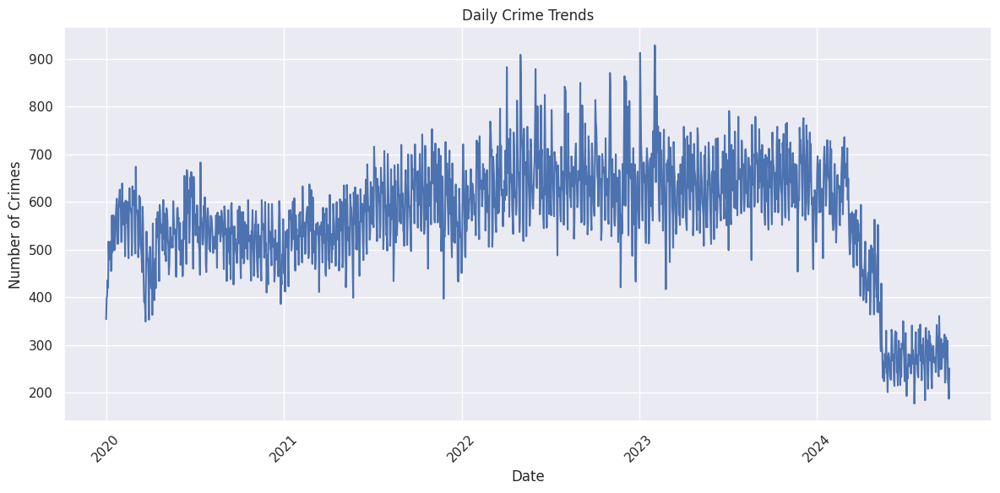

In [58]:
plt.figure(figsize=(12, 6))
plt.plot(daily_crime['DateReported'], daily_crime['Crime_Count'])
plt.title('Daily Crime Trends')
plt.xlabel('Date')
plt.ylabel('Number of Crimes')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


In [59]:
model = ARIMA(daily_crime['Crime_Count'], order=(1, 1, 1))
model_fit = model.fit()
model_fit


In [60]:
forecast_steps = 30
forecast = model_fit.forecast(steps=forecast_steps)

last_date = daily_crime['DateReported'].iloc[-1]
forecast_dates = pd.date_range(start=last_date + pd.Timedelta(days=1), periods=forecast_steps)


In [61]:
# Create DataFrames for observed and forecast data
forecast_df = pd.DataFrame({'DateReported': forecast_dates, 'Crime_Count': forecast, 'Type': 'Forecast'})
observed_df = daily_crime.copy()
observed_df['Type'] = 'Observed'

# Combine observed and forecast data
combined_df = pd.concat([observed_df, forecast_df])

In [62]:
fig = go.Figure()

# Add observed data
fig.add_trace(
    go.Scatter(x=combined_df.loc[combined_df['Type'] == 'Observed', 'DateReported'], 
               y=combined_df.loc[combined_df['Type'] == 'Observed', 'Crime_Count'], 
               mode='lines+markers', name='Observed')
)

# Add forecast data
fig.add_trace(
    go.Scatter(x=combined_df.loc[combined_df['Type'] == 'Forecast', 'DateReported'], 
               y=combined_df.loc[combined_df['Type'] == 'Forecast', 'Crime_Count'], 
               mode='lines', name='Forecast', line=dict(color='red'))
)

# Update layout
fig.update_layout(
    title='Crime Count Forecast',
    xaxis_title='Date',
    yaxis_title='Number of Crimes',
    legend_title='Legend',
    hovermode='x unified',
    height=600,
    width=1200
)

fig.show()


#### Based on the forecast data provided, I can draw the following conclusions about the predicted crime rates for the next 30 days:<br>
#### Initial Increase: 
There's a slight increase in the predicted crime rate from October 1st (261.76) to October 2nd (264.73), suggesting a short-term uptick at the beginning of the month.
#### Stabilization: 
After October 3rd, the forecast shows a rapid stabilization of crime rates. The predicted number of crimes per day settles at approximately 265.87 by October 7th.
#### Consistency: 
From October 8th onwards, the forecast predicts an extremely stable crime rate, with the number of daily crimes remaining constant at 265.87 (rounded to two decimal places).
#### Lack of Variability: 
The forecast doesn't show any day-to-day variations after October 8th, which is unusual for real-world crime data. This suggests that the model might be oversimplifying long-term predictions.
#### No Seasonal Patterns: 
The forecast doesn't indicate any weekly patterns or fluctuations that might be expected (e.g., higher crime rates on weekends).
#### Overall Trend: 
There's a very slight upward trend from the beginning to the end of the 30-day period, with the crime rate increasing by about 1.6% (from 261.76 to 265.87).